このNotebookは、.dcmファイルを.npyファイルに変換するためのものです。  
なお、[RSNA-IAD | Ensemble | LB #1 ](https://www.kaggle.com/code/ataracsia/rsna-iad-ensemble-lb-1/edit) の前処理を利用しています。

# 1. Configurations

In [1]:
IMAGE_SIZE = 256
NUM_SLICES = 500
USE_WINDOWING = True
CONTINUED = False # Whether to continue from a specific series
START_SERIES = '' # SeriesInstanceUID to start from if CONTINUED is True

# Competition constants
ID_COL = 'SeriesInstanceUID'

LABEL_COLS = [
    
    'Left Infraclinoid Internal Carotid Artery',
    'Right Infraclinoid Internal Carotid Artery',
    'Left Supraclinoid Internal Carotid Artery',
    'Right Supraclinoid Internal Carotid Artery',
    'Left Middle Cerebral Artery',
    'Right Middle Cerebral Artery',
    'Anterior Communicating Artery',
    'Left Anterior Cerebral Artery',
    'Right Anterior Cerebral Artery',
    'Left Posterior Communicating Artery',
    'Right Posterior Communicating Artery',
    'Basilar Tip',
    'Other Posterior Circulation',
    'Aneurysm Present',
]

class Configuration:
    
    image_size = IMAGE_SIZE
    num_slices = NUM_SLICES
    use_windowing = True
    continued = CONTINUED
    start_series = START_SERIES

CFG = Configuration()


# 2. Import

In [2]:
import os
import pathlib
import sys
import gc
import json
import shutil
from tqdm.notebook import tqdm
import warnings
warnings.filterwarnings('ignore')
from pathlib import Path
from collections import defaultdict
from typing import List, Dict, Optional, Tuple
from IPython.display import display

# Data handling
import numpy as np
import polars as pl
import pandas as pd

# Medical imaging
import pydicom
import cv2

# ML/DL
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.cuda.amp import autocast
import timm

# Transformations
import albumentations as A
from albumentations.pytorch import ToTensorV2

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import PIL.Image as Image

# Competition API
# import kaggle_evaluation.rsna_inference_server

# Set device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")


Using device: cuda


# 3. Functions

In [ ]:
def get_windowing_params(modality: str) -> Tuple[float, float]:
    """Get appropriate windowing for different modalities"""
    windows = {
        'CT': (40, 80),
        'CTA': (50, 350),
        'MRA': (600, 1200),
        'MRI': (40, 80),
    }
    # keyからvalueを取得
    return windows.get(modality, (40, 80))

def apply_dicom_windowing(img: np.ndarray,
                          window_center: float,
                          window_width: float) -> np.ndarray:
    """Apply DICOM windowing"""
    img_min = window_center - window_width // 2
    img_max = window_center + window_width // 2
    img = np.clip(img, img_min, img_max)
    img = (img - img_min) / (img_max - img_min + 1e-7)
    return (img * 255)#.astype(np.uint8)

def process_dicom_series(series_path: str) -> Tuple[np.ndarray, Dict]:
    """Process a DICOM series and extract metadata"""
    series_path = Path(series_path)
    
    # Find all DICOM files
    all_filepaths = []
    for root, _, files in os.walk(series_path):
        for file in files:
            if file.endswith('.dcm'):
                all_filepaths.append(os.path.join(root, file))
    all_filepaths.sort()
    
    if len(all_filepaths) == 0:
        # Return default values
        volume = np.zeros((CFG.num_slices, CFG.image_size, CFG.image_size),
                          dtype=np.uint8
                          )
        metadata = {'age': 50, 'sex': 0, 'modality': 'CT'}
        return volume, metadata
    
    # Process DICOM files
    slices = []
    metadata = {}
    
    for i, filepath in enumerate(all_filepaths):
        try:
            ds = pydicom.dcmread(filepath, force=True)
            img = ds.pixel_array.astype(np.float32)
            
            # Handle multi-frame or color images
            if img.ndim == 3:
                if img.shape[-1] == 3:
                    img = cv2.cvtColor(img.astype(np.uint8), # img
                                       cv2.COLOR_BGR2GRAY).astype(np.float32)
                else:
                    img = img[:, :, 0]
            
            # Extract metadata from first file
            if i == 0:
                metadata['modality'] = getattr(ds, 'Modality', 'CT')

                # 'PatientAge'属性を取得（デフォルト値は'050Y'）
                try:
                    age_str = getattr(ds, 'PatientAge', '050Y')
                    age = int(''.join(filter(str.isdigit, age_str[:3])) or '50')
                    metadata['age'] = min(age, 100)
                except:
                    metadata['age'] = 50

                # 'PatientSex'属性を取得（デフォルト値は'M'）
                try:
                    sex = getattr(ds, 'PatientSex', 'M')
                    metadata['sex'] = 1 if sex == 'M' else 0
                except:
                    metadata['sex'] = 0
            
            # Apply rescale if available
            if hasattr(ds, 'RescaleSlope') and hasattr(ds, 'RescaleIntercept'):
                img = img * ds.RescaleSlope + ds.RescaleIntercept
            
            # Apply windowing
            # Modalityに合わせたWindowingの処理を行う
            if CFG.use_windowing:
                window_center, window_width = get_windowing_params(metadata['modality'])
                img = apply_dicom_windowing(img, window_center, window_width)
            else:
                img_min, img_max = img.min(), img.max()
                # MinMaxスケーリング
                if img_max > img_min:
                    img = ((img - img_min) / (img_max - img_min) * 255)#.astype(np.uint8)
                else:
                    img = np.zeros_like(img, dtype=np.uint8)
            
            # Resize０img * ds.RescaleSlope + ds.RescaleIntercept
            
            # Apply windowing
            # Modalityに合わせたWindowingの処理を行う
            if CFG.use_windowing:
                window_center, window_width = get_windowing_params(metadata['modality'])
                img = apply_dicom_windowing(img, window_center, window_width)
            else:
                img_min, img_max = img.min(), img.max()
                # MinMaxスケーリング
                if img_max > img_min:
                    img = ((img - img_min) / (img_max - img_min) * 255)#.astype(np.uint8)
                else:
                    img = np.zeros_like(img, dtype=np.uint8)
            
            # Resize
            img = cv2.resize(img, (CFG.image_size, CFG.image_size))
            slices.append(img)
            
        except Exception as e:
            print(f"Error processing {filepath}: {e}")
            continue
    
    # Handle slice sampling
    if len(slices) == 0:
        volume = np.zeros((CFG.num_slices, CFG.image_size, CFG.image_size), dtype=np.uint8)
    else:
        volume = np.array(slices)
        # if len(slices) > CFG.num_slices:
        #     indices = np.linspace(0, len(slices) - 1, CFG.num_slices).astype(int)
        #     volume = volume[indices]
        # # 枚数 < num_slicesの場合、0次元にパディング
        # elif len(slices) < CFG.num_slices:
        #     pad_size = CFG.num_slices - len(slices)
        #     volume = np.pad(volume, ((0, pad_size), (0, 0), (0, 0)), mode='edge')
    return volume, metadata


In [6]:
# test
volume, metadata = process_dicom_series('../series/1.2.826.0.1.3680043.8.498.10035643165968342618460849823699311381')
print(volume.shape)
print(np.unique(volume[1]))


image size: (512, 512)
unique: (array([  0.      ,   2.540039,   5.080078,   7.620117,  10.160156,
        12.700195,  15.240234,  17.780273,  20.320312,  22.860352,
        25.40039 ,  27.94043 ,  30.480469,  33.020508,  35.560547,
        38.100586,  40.640625,  43.180664,  45.720703,  48.260742,
        50.80078 ,  53.34082 ,  55.88086 ,  58.4209  ,  60.960938,
        63.500977,  63.75    ,  66.041016,  68.581055,  68.83008 ,
        71.12109 ,  71.37012 ,  73.66113 ,  73.91016 ,  76.20117 ,
        76.450195,  78.74121 ,  78.990234,  81.28125 ,  81.53027 ,
        83.82129 ,  84.07031 ,  86.36133 ,  86.61035 ,  88.90137 ,
        89.15039 ,  91.44141 ,  91.69043 ,  93.981445,  94.23047 ,
        96.521484,  96.77051 ,  99.06152 ,  99.31055 , 101.60156 ,
       101.850586, 104.1416  , 104.390625, 106.68164 , 106.930664,
       109.22168 , 109.4707  , 111.76172 , 112.01074 , 114.30176 ,
       114.55078 , 116.8418  , 117.09082 , 119.381836, 119.63086 ,
       121.921875, 122.1709  ,

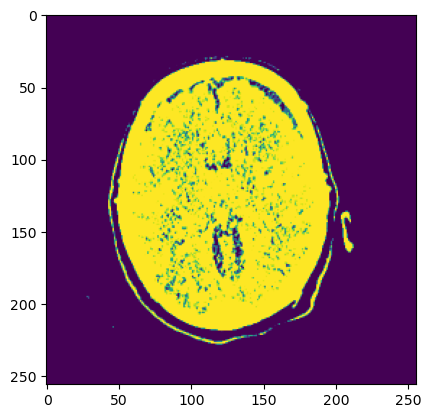

In [7]:
plt.imshow(volume[1])


In [6]:
# image = Image.fromarray(volume[1], mode='L')
# print(image.mode)
# image.save('test.png')


# 4. Conversion

In [ ]:
# 解像度別の保存先ディレクトリの作成
dir_path = f'../series_npy/{CFG.image_size}'
os.makedirs(dir_path, exist_ok=True)

# series内のディレクトリをリストに入れて取得
series_path = [\
    f'../series/{d}' for d in os.listdir('../series') \
        if os.path.isdir(f'../series/{d}')
]
print(f'Total series: {len(series_path)}')

# 途中から始める場合のseries_path
if CFG.continued:
    
    # すでに変換済みのSeriesInstanceUIDを取得
    processed_series = os.listdir('../series_npy/512/')
    # 念のため、最後に変換したSeriesInstanceUIDをリストから削除
    processed_series.remove(CFG.start_series)
    # 全てのSeriesInstanceUIDの中から、変換済みのものを除外
    series_path = [path for path in series_path if Path(path).name not in processed_series]
    print(f'Continuing from {CFG.start_series}, {len(series_path)}')

meta_df = pd.DataFrame()

for path in series_path:
    
    # 各Seriesごとにディレクトリを作成
    save_path = f'{dir_path}/{Path(path).name}'
    os.makedirs(save_path, exist_ok=True)
    
    # volumeとmetadataの取得
    volume, metadata = process_dicom_series(path)
    
    for i in range(len(volume)):
        
        # 一枚一枚保存する
        image = volume[i]
        image_i = str(i).zfill(5)
        npy_path = f"{save_path}/{image_i}.npy"
        np.save(npy_path, image)


Total series: 4348
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (512, 512)
image size: (51

In [ ]:
# 解像度別の保存先ディレクトリの作成
dir_path = f'../series_npy/{CFG.image_size}'
os.makedirs(dir_path, exist_ok=True)

# series内のディレクトリをリストに入れて取得
series_path = [f'../series/{d}' for d in os.listdir('./series') if os.path.isdir(f'../series/{d}')]
print(f'Total series: {len(series_path)}')

# 途中から始める場合のseries_path
if CFG.continued:
    
    # すでに変換済みのSeriesInstanceUIDを取得
    processed_series = os.listdir('./series_npy/512/')
    # 念のため、最後に変換したSeriesInstanceUIDをリストから削除
    processed_series.remove(CFG.start_series)
    # 全てのSeriesInstanceUIDの中から、変換済みのものを除外
    series_path = [path for path in series_path if Path(path).name not in processed_series]
    print(f'Continuing from {CFG.start_series}, {len(series_path)}')

meta_df = pd.DataFrame()

for path in series_path:
    
    # 各Seriesごとにディレクトリを作成
    save_path = f'{dir_path}/{Path(path).name}'
    os.makedirs(save_path, exist_ok=True)
    
    # volumeとmetadataの取得
    _, metadata = process_dicom_series(path)
    
    # meta_df
    meta_df = pd.concat([meta_df, pd.DataFrame(
        {
            'SeriesInstanceUID': [Path(path).name],
            'modalisy': [metadata['modality']],
            'age': [metadata['age']],
            'sex': [metadata['sex']]
        }
    )])

os.makedirs(f'../meta_data/{CFG.image_size}', exist_ok=True)       
meta_df.to_csv(f'../meta_data/{CFG.image_size}/meta.csv', index=False)


Total series: 4348


In [ ]:
meta_df


,SeriesInstanceUID,modalisy,age,sex
0,1.2.826.0.1.3680043.8.498.10004044428023505108...,MR,65,0
0,1.2.826.0.1.3680043.8.498.10004684224894397679...,MR,75,0
0,1.2.826.0.1.3680043.8.498.10005158603912009425...,CT,60,1
0,1.2.826.0.1.3680043.8.498.10009383108068795488...,MR,70,1
0,1.2.826.0.1.3680043.8.498.10012790035410518400...,MR,50,0
...,...,...,...,...
0,1.2.826.0.1.3680043.8.498.99915610493694667606...,MR,50,0
0,1.2.826.0.1.3680043.8.498.99920680741054836990...,MR,75,0
0,1.2.826.0.1.3680043.8.498.99953513260518059135...,CT,44,0
0,1.2.826.0.1.3680043.8.498.99982144859397209076...,MR,50,0
